$\Large\color{red}{\text{Announce: ebook "PyGMTSAR: Sentinel-1 Python InSAR: An Introduction"}}$
$\Large\color{red}{\text{is now available on Amazon, Apple, Kobo and many other bookstores.}}$

$\Large\color{blue}{\text{PyGMTSAR 2023 Golden Valley, CA}}$
$\Large\color{blue}{\text{Sentinel-1 Scenes Downloading from Alaska Satellite Facility (ASF)}}$

### Look for more PyGMTSAR examples:

* Google Colab - see GitHub page for [notebooks](https://github.com/mobigroup/gmtsar),

* Docker Images on [DockerHub](https://hub.docker.com/r/mobigroup/pygmtsar),

* GitHub [notebooks](https://github.com/mobigroup/gmtsar/tree/master/notebooks),

* GitHub Actions [console scripts](https://github.com/mobigroup/gmtsar/actions),

* Google Cloud VM -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Linux Debian and Ubuntu -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/),

* Apple Silicon and Intel hosts -  follow [PyGMTSAR documentation](https://mobigroup.github.io/gmtsar/).


### PyGMTSAR InSAR library, Geomed3D Geophysical Inversion Library, N-Cube 3D/4D GIS Data Visualization, etc. are my free-time Open Source projects.

I have STEM master’s degree in radio physics and in 2004 I have got the first prize of the All-Russian Physics competition for significant results in forward and inverse modeling for non-linear optics and holography, also applicable for modeling of Gravity, Magnetic, and Thermal fields and satellite interferometry processing. And I’m data scientist and software developer with 20 year’s experience in science and industrial development. I had been working on government contracts and universities projects and on projects for LG Corp, Google Inc, etc.

### You can sponsor my work on [Patreon](https://www.patreon.com/pechnikov) where I share my projects updates, publications, use cases, examples, and other useful information. To order some research and development and support, see my profile on freelance platform [Upwork](https://www.upwork.com/freelancers/~01e65e8e7221758623).

### Resources

* [Patreon](https://www.patreon.com/pechnikov),

* [YouTube Geological Models](https://www.youtube.com/channel/UCSEeXKAn9f_bDiTjT6l87Lg),

* [Virtual and Augmented Reality (VR/AR) Geological Models](https://mobigroup.github.io/ParaView-Blender-AR/),

* [GitHub](https://github.com/mobigroup),

* [LinkedIn](https://www.linkedin.com/in/alexey-pechnikov/),

* [Medium](https://medium.com/@pechnikov),

* [Habr](https://habr.com/ru/users/N-Cube/posts/).

### @ Alexey Pechnikov, 2023

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [ ]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [ ]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !export DEBIAN_FRONTEND=noninteractive
        !apt-get update > /dev/null
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt  > /dev/null
        # GMTSAR codes are not so good to be compiled by modern GCC
        !apt install gcc-9 > /dev/null
        !update-alternatives --install /usr/bin/gcc gcc /usr/bin/gcc-9 10
        !update-alternatives --config gcc
        !gcc --version | head -n 1
        !rm -fr /usr/local/GMTSAR
        !git config --global advice.detachedHead false
        !cd /usr/local && git clone -q --branch master https://github.com/gmtsar/gmtsar GMTSAR
        # revert recent broken commit
        !cd /usr/local/GMTSAR && git checkout e98ebc0f4164939a4780b1534bac186924d7c998 > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null
        # fix for missed script, use bash instead of csh interpretator
        # note: csh messes stdout and stderr in Docker environment, it's resolved in PyGMTSAR code
        !echo '#!/bin/sh' > /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !echo echo /usr/local/GMTSAR/share/gmtsar >> /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !chmod a+x /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !/usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        # test one GMTSAR binary
        !/usr/local/GMTSAR/bin/make_s1a_tops 2>&1 | head -n 2





update-alternatives: using /usr/bin/gcc-9 to provide /usr/bin/gcc (gcc) in auto mode
There is only one alternative in link group gcc (providing /usr/bin/gcc): /usr/bin/gcc-9
Nothing to configure.
gcc (Ubuntu 9.5.0-1ubuntu1~22.04) 9.5.0
HEAD is now at e98ebc0 extending solid_tide to 2050 as leap seconds are abandoned hopefully
/usr/local/GMTSAR/share/gmtsar
 
Usage: make_slc_s1a_tops xml_file tiff_file output mode dr.grd da.grd


In [ ]:
import sys
if 'google.colab' in sys.modules:
    !apt install -y xvfb > /dev/null
    !{sys.executable} -m pip install pyvista xvfbwrapper > /dev/null
    import xvfbwrapper
    display = xvfbwrapper.Xvfb(width=800, height=600)
    display.start()

### Define ENV Variables for Jupyter Instance

In [ ]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

env: PATH=/opt/bin:/usr/local/nvidia/bin:/usr/local/cuda/bin:/usr/local/sbin:/usr/local/bin:/usr/sbin:/usr/bin:/sbin:/bin:/tools/node/bin:/tools/google-cloud-sdk/bin:/usr/local/GMTSAR/bin/


### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [ ]:
!{sys.executable} --version

Python 3.10.12


In [ ]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install matplotlib seaborn adjustText bokeh >/dev/null
    !{sys.executable} -m pip install -q git+https://github.com/mobigroup/gmtsar.git@pygmtsar2#subdirectory=pygmtsar

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.8/42.8 kB 759.3 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.7/53.7 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 345.8/345.8 kB 19.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.8/65.8 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 26.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 9.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 90.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 341.8/341.8 kB 27.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 69.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 68.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 97.5 MB/s 

## Load and Setup Python Modules

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import geopandas as gpd
import json
from dask.distributed import Client
import dask
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# plotting modules
import pyvista as pv
# magic trick for white background
pv.set_plot_theme("document")
import panel
panel.extension('vtk')
import seaborn as sns
import adjustText
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [ ]:
# define Pandas display settings
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 100)
pd.set_option('display.max_colwidth', 100)

In [ ]:
from pygmtsar import S1, Stack, tqdm_dask, NCubeVTK, ASF, XYZTiles

## Define Sentinel-1 SLC Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

### Descending Orbit Configuration

In [ ]:
SCENES = """
S1A_IW_SLC__1SDV_20230530T165926_20230530T165953_048766_05DD5A_6977
S1A_IW_SLC__1SDV_20230518T165926_20230518T165953_048591_05D81D_EABF
S1A_IW_SLC__1SDV_20230506T165925_20230506T165952_048416_05D2DC_4F12
S1A_IW_SLC__1SDV_20230412T165924_20230412T165951_048066_05C724_2FDB
S1A_IW_SLC__1SDV_20230319T165923_20230319T165950_047716_05BB55_2FFC
S1A_IW_SLC__1SDV_20230223T165923_20230223T165950_047366_05AF7B_2D83
S1A_IW_SLC__1SDV_20230106T165925_20230106T165952_046666_0597E6_2460
S1A_IW_SLC__1SDV_20221225T165925_20221225T165952_046491_059202_A674
S1A_IW_SLC__1SDV_20221119T165927_20221119T165954_045966_05801A_69BA
S1A_IW_SLC__1SDV_20221026T165928_20221026T165955_045616_05744A_9471
S1A_IW_SLC__1SDV_20221014T165928_20221014T165955_045441_056F18_AAEB
S1A_IW_SLC__1SDV_20220908T165927_20220908T165954_044916_055D72_EA36
S1A_IW_SLC__1SDV_20220710T165924_20220710T165951_044041_0541C2_0BC7
S1A_IW_SLC__1SDV_20220616T165922_20220616T165949_043691_053750_435F
S1A_IW_SLC__1SDV_20220511T165920_20220511T165947_043166_0527BE_11DC
S1A_IW_SLC__1SDV_20220429T165919_20220429T165946_042991_0521FB_302F
S1A_IW_SLC__1SDV_20220417T165918_20220417T165945_042816_051C40_3336
S1A_IW_SLC__1SDV_20211124T165921_20211124T165948_040716_04D4EA_F772
S1A_IW_SLC__1SDV_20211112T165921_20211112T165948_040541_04CEDB_D749
S1A_IW_SLC__1SDV_20211019T165922_20211019T165949_040191_04C2B3_F9C6
S1A_IW_SLC__1SDV_20210925T165921_20210925T165948_039841_04B688_8E6D
S1A_IW_SLC__1SDV_20210913T165921_20210913T165948_039666_04B0A2_A6D0
S1A_IW_SLC__1SDV_20210901T165920_20210901T165947_039491_04AA91_78BC
S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B
S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11
S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F
S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599
S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF
"""
SCENES = list(filter(None, SCENES.split('\n')))
print (f'Scenes defined: {len(SCENES)}')

ORBIT     = 'A'
SUBSWATH  = 2
REFERENCE = '2022-05-11'

Scenes defined: 28


In [ ]:
WORKDIR = 'raw_gastein_desc'  if ORBIT == 'D' else 'raw_gastein_asc'
DATADIR = 'data_gastein_desc' if ORBIT == 'D' else 'data_gastein_asc'

In [ ]:
geojson = '''
{
  "type": "Feature",
  "properties": {},
  "geometry": {
    "type": "Polygon",
    "coordinates": [
      [
        [ 13.108182931161901, 47.216424699184728 ],
        [ 13.19795430925635,  47.216424699184728 ],
        [ 13.19795430925635,  47.254534678531407 ],
        [ 13.108182931161901, 47.254534678531407 ],
        [ 13.108182931161901, 47.216424699184728 ]
      ]
    ]
  }
}
'''
AOI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
AOI

,geometry
0,"POLYGON ((13.10818 47.21642, 13.19795 47.21642, 13.19795 47.25453, 13.10818 47.25453, 13.10818 4..."


In [ ]:
BUFFER = 0.02
AOI['geometry'] = AOI.buffer(BUFFER)
AOI

,geometry
0,"POLYGON ((13.08818 47.21642, 13.08818 47.25453, 13.08828 47.25650, 13.08857 47.25844, 13.08904 4..."


In [ ]:
# subsidence point 47.24145°, 13.180524°
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [13.180524, 47.24145]
  },
  "properties": {}
}
'''
POI = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI

,geometry
0,POINT (13.18052 47.24145)


In [ ]:
# almost stable point 47.241072°, 13.184132°
geojson = '''
{
  "type": "Feature",
  "geometry": {
    "type": "Point",
    "coordinates": [13.184132, 47.241072]
  },
  "properties": {}
}
'''
POI0 = gpd.GeoDataFrame.from_features([json.loads(geojson)])
POI0

,geometry
0,POINT (13.18413 47.24107)


## Download and Unpack Datasets

## Enter Your ASF (Earthdata) User and Password

If the data directory is empty or doesn't exist, you'll need to download Sentinel-1 scenes from the Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you don't have an Earthdata Login, you can create one at https://urs.earthdata.nasa.gov//users/new

You can also use pre-existing SLC scenes stored on your Google Drive, or you can copy them using a direct public link from iCloud Drive.

The credentials below are available at the time the notebook is validated. Special symbols, like underscores, are required in your ASF password.

In [ ]:
# Set these variables to None and you will be prompted to enter your username and password below.
username = 'GoogleColab2023'
password = 'GoogleColab_2023'

In [ ]:
# download required polarization and subswaths only
asf = ASF(username, password)
asf.download(DATADIR, SCENES, SUBSWATH)

ASF Downloading Sentinel-1 SLC:   0%|          | 0/28 [00:00<?, ?it/s]

ASF Downloading Sentinel-1 Orbits:   0%|          | 0/28 [00:00<?, ?it/s]

,scene,orbit
0,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210605T121752_V20210515T225942...
1,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210617T121749_V20210527T225942...
2,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210629T121939_V20210608T225942...
3,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210804T121853_V20210714T225942...
4,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210909T122034_V20210819T225942...
5,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210901T165920_20210901T165947_039491_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20210921T122000_V20210831T225942...
6,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210913T165921_20210913T165948_039666_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20211003T122049_V20210912T225942...
7,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20210925T165921_20210925T165948_039841_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20211015T122336_V20210924T225942...
8,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20211019T165922_20211019T165949_040191_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20211108T122749_V20211018T225942...
9,https://datapool.asf.alaska.edu/SLC/SA/S1A_IW_SLC__1SDV_20211112T165921_20211112T165948_040541_0...,https://s1qc.asf.alaska.edu/aux_poeorb/S1A_OPER_AUX_POEORB_OPOD_20211202T122327_V20211111T225942...


## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [ ]:
# simple Dask initialization
if 'client' in globals():
    client.close()
client = Client()
client

INFO:distributed.http.proxy:To route to workers diagnostics web server please install jupyter-server-proxy: python -m pip install jupyter-server-proxy
INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:36503
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:8787/status
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34249'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35889'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:42489'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35761'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:34817', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:34817
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:56090
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:37789', name: 2, stat

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 51.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:36503,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 51.00 GiB
Comm: tcp://127.0.0.1:44601,Total threads: 2
Dashboard: http://127.0.0.1:45125/status,Memory: 12.75 GiB
Nanny: tcp://127.0.0.1:34249,


## Init

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Select Original Secenes and Orbits

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [ ]:
scenes = S1.scan_slc(DATADIR, subswath=SUBSWATH)

In [ ]:
sbas = Stack(WORKDIR, drop_if_exists=True).set_scenes(scenes).set_reference(REFERENCE)
sbas.to_dataframe()

NOTE: auto set reference scene 2021-05-16. You can change it like Stack.set_reference("2022-01-20")


,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2021-05-16,2021-05-16 16:59:16,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210516T165914_20210516T165941_037916_047989_3ECF.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210605T121752_V20210515T225942_20210517T005942.EOF,"MULTIPOLYGON (((12.68817 46.89459, 12.75470 46.90285, 12.82228 46.91120, 12.88635 46.91909, 12.9..."
2021-05-28,2021-05-28 16:59:17,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210528T165915_20210528T165942_038091_047ED3_A599.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210617T121749_V20210527T225942_20210529T005942.EOF,"MULTIPOLYGON (((12.68852 46.89466, 12.75505 46.90293, 12.82262 46.91128, 12.88669 46.91916, 12.9..."
2021-06-09,2021-06-09 16:59:17,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210609T165916_20210609T165943_038266_0483FE_CD3F.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210629T121939_V20210608T225942_20210610T005942.EOF,"MULTIPOLYGON (((12.68823 46.89453, 12.75476 46.90280, 12.82234 46.91115, 12.88640 46.91903, 12.9..."
2021-07-15,2021-07-15 16:59:20,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210715T165918_20210715T165945_038791_0493BD_1F11.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210804T121853_V20210714T225942_20210716T005942.EOF,"MULTIPOLYGON (((12.68709 46.89457, 12.75362 46.90283, 12.82120 46.91118, 12.88527 46.91907, 12.9..."
2021-08-20,2021-08-20 16:59:22,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210820T165920_20210820T165947_039316_04A493_136B.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210909T122034_V20210819T225942_20210821T005942.EOF,"MULTIPOLYGON (((12.68848 46.89463, 12.75502 46.90290, 12.82259 46.91125, 12.88666 46.91913, 12.9..."
2021-09-01,2021-09-01 16:59:22,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210901T165920_20210901T165947_039491_04AA91_78BC.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210901T165920_20210901T165947_039491_04AA91_78BC.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20210921T122000_V20210831T225942_20210902T005942.EOF,"MULTIPOLYGON (((12.68718 46.89453, 12.75372 46.90280, 12.82129 46.91115, 12.88536 46.91903, 12.9..."
2021-09-13,2021-09-13 16:59:23,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210913T165921_20210913T165948_039666_04B0A2_A6D0.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210913T165921_20210913T165948_039666_04B0A2_A6D0.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20211003T122049_V20210912T225942_20210914T005942.EOF,"MULTIPOLYGON (((12.68666 46.89552, 12.75319 46.90378, 12.82076 46.91213, 12.88786 46.92038, 12.9..."
2021-09-25,2021-09-25 16:59:23,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20210925T165921_20210925T165948_039841_04B688_8E6D.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20210925T165921_20210925T165948_039841_04B688_8E6D.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20211015T122336_V20210924T225942_20210926T005942.EOF,"MULTIPOLYGON (((12.68729 46.89498, 12.75382 46.90325, 12.82140 46.91160, 12.88547 46.91948, 12.9..."
2021-10-19,2021-10-19 16:59:24,A,S1A,VV,2,data_gastein_asc/S1A_IW_SLC__1SDV_20211019T165922_20211019T165949_040191_04C2B3_F9C6.SAFE/measur...,data_gastein_asc/S1A_IW_SLC__1SDV_20211019T165922_20211019T165949_040191_04C2B3_F9C6.SAFE/annota...,data_gastein_asc/S1A_OPER_AUX_POEORB_OPOD_20211108T122749_V20211018T225942_20211020T005942.EOF,"MULTIPOLYGON (((12.68751 46.89508, 12.75405 46.90334,

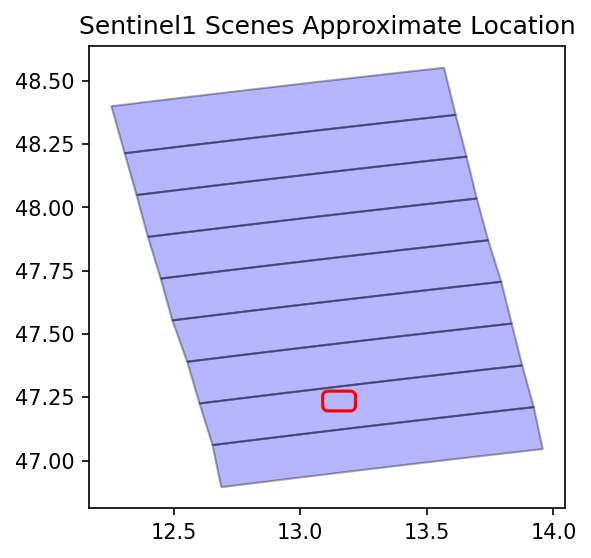

In [ ]:
plt.figure(figsize=(8, 4), dpi=150)
gdf = sbas.to_dataframe()
cmap = matplotlib.colormaps['bwr']
colors = dict([(v, cmap(k)) for k, v in enumerate(gdf.index.unique())])
gdf.reset_index().plot(color=[colors[k] for k in gdf.index], alpha=0.01, edgecolor='black', ax=plt.gca())
AOI.boundary.plot(ax=plt.gca(), color='red')
plt.title('Sentinel1 Scenes Approximate Location', fontsize=12)
plt.show()

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

In [ ]:
sbas.compute_reframe(AOI)

Reframing:   0%|          | 0/28 [00:00<?, ?it/s]

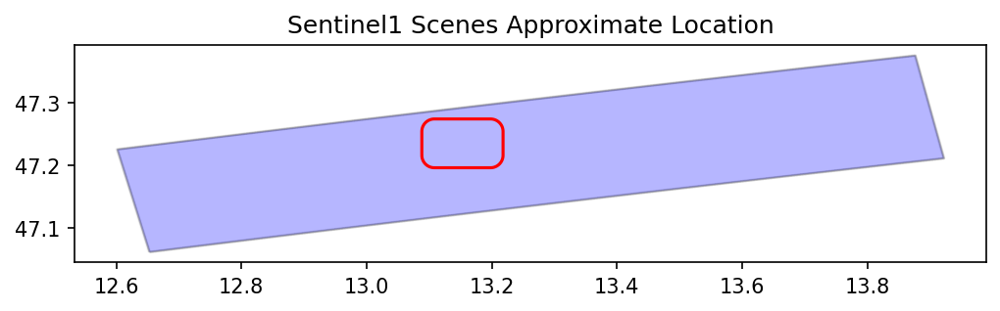

In [ ]:
plt.figure(figsize=(8, 4), dpi=150)
gdf = sbas.to_dataframe()
cmap = matplotlib.colormaps['bwr']
colors = dict([(v, cmap(k)) for k, v in enumerate(gdf.index.unique())])
gdf.reset_index().plot(color=[colors[k] for k in gdf.index], alpha=0.01, edgecolor='black', ax=plt.gca())
AOI.boundary.plot(ax=plt.gca(), color='red')
plt.title('Sentinel1 Scenes Approximate Location', fontsize=12)
plt.show()

### Download SRTM DEM

The function below downloads SRTM1 or SRTM3 DEM and converts heights to ellipsoidal model using EGM96 grid.
Besides, for faster processing we can use pre-defined DEM file as explained above. Select product=SRTM1 for 30m resolution and product=SRTM3 for 90m resolution SRTM DEM.

In [ ]:
# define the area of interest (AOI) to speedup the processing
sbas.download_dem(AOI)

DEM Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

grdblend [NOTICE]: Remote data courtesy of GMT data server oceania [http://oceania.generic-mapping-tools.org]
grdblend [NOTICE]: Earth Relief at 1x1 arc seconds tiles provided by SRTMGL1 (land only) [NASA/USGS].
grdblend [NOTICE]:   -> Download 1x1 degree grid tile (earth_relief_01s_g): N47E013
INFO:distributed.scheduler:Receive client connection: Client-worker-53f67af6-8dcd-11ee-a2c1-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:43444


## Load Copernicus DEM

In [ ]:
# download the tile
#!wget -c https://copernicus-dem-30m.s3.amazonaws.com/Copernicus_DSM_COG_10_N47_00_E013_00_DEM/Copernicus_DSM_COG_10_N47_00_E013_00_DEM.tif

In [ ]:
# load the tile
#sbas.load_dem('Copernicus_DSM_COG_10_N47_00_E013_00_DEM.tif', AOI)

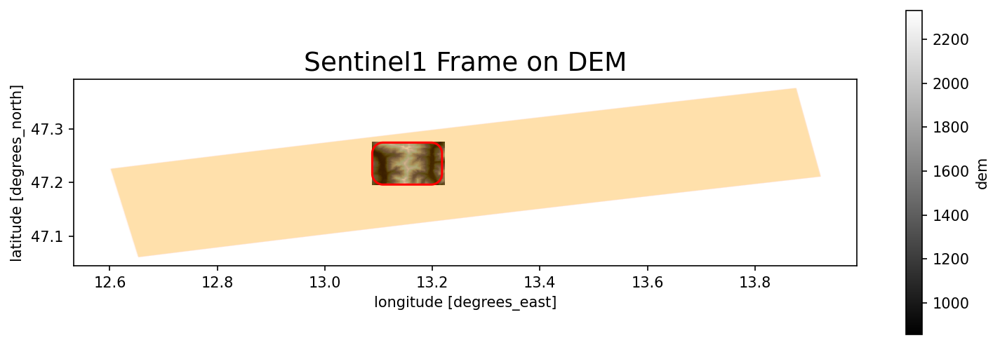

In [ ]:
plt.figure(figsize=(12,4), dpi=150)
dem = sbas.get_dem()
dem[::4,::4].plot.imshow(cmap='gray')
sbas.to_dataframe().plot(color='orange', alpha=0.01, ax=plt.gca())
AOI.boundary.plot(ax=plt.gca(), color='red', alpha=1)
plt.title('Sentinel1 Frame on DEM', fontsize=18)
plt.show()

## Align Images

In [ ]:
sbas.compute_align()

Aligning Reference:   0%|          | 0/1 [00:00<?, ?it/s]

Aligning Repeat:   0%|          | 0/27 [00:00<?, ?it/s]

Convert Subswath:   0%|          | 0/28 [00:00<?, ?it/s]

## Backup

In [ ]:
# bursts-cropped GeoTIFF files moved into backup directory
sbas.backup('backup')

In [ ]:
# free disk space removing the cropped Sentinel-1 GeoTIFFs
# alternatively, drop the data directory and use the backup
!rm -fr backup

## Geocoding Transform

In [ ]:
# use the original Sentinel-1 resolution (1 pixel spacing)
sbas.compute_geocode(1)

Radar Transform Computing:   0%|          | 0/2 [00:00<?, ?it/s]

Radar Transform Saving:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-ceb8ab9b-8dcd-11ee-a2bf-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:50634
INFO:distributed.scheduler:Receive client connection: Client-worker-ceb94048-8dcd-11ee-a2b8-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:50642
INFO:distributed.scheduler:Receive client connection: Client-worker-ceba4f39-8dcd-11ee-a2bb-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:50654


Radar Transform Indexing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Inverse Transform Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
topo = sbas.get_topo()
topo

<xarray.DataArray 'topo' (y: 748, x: 3161)>
dask.array<xarray-ele, shape=(748, 3161), dtype=float32, chunksize=(748, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 494.5 495.5 496.5 497.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x        (x) float64 9.464e+03 9.466e+03 9.466e+03 ... 1.262e+04 1.262e+04

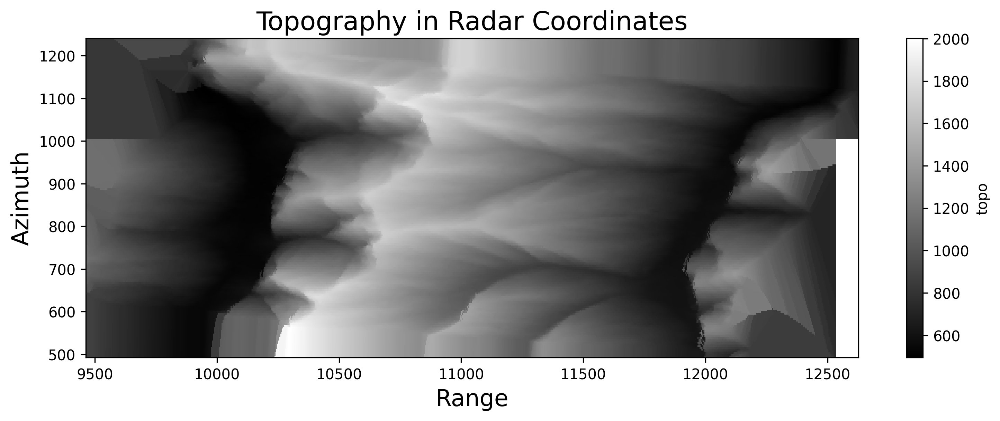

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
topo[::4,::4].plot.imshow(cmap='gray')
plt.xlabel('Range', fontsize=16)
plt.ylabel('Azimuth', fontsize=16)
plt.title('Topography in Radar Coordinates', fontsize=18)
plt.show()

## SBAS Baseline

In [ ]:
#baseline_pairs = sbas.sbas_pairs(days=180, meters=150)
baseline_pairs = sbas.sbas_pairs(days=300, meters=200)
# optionally, drop dates having less then 2 pairs
baseline_pairs = sbas.sbas_pairs_limit(baseline_pairs, limit=3, iterations=2)
# optionally, drop all pairs connected to the specified dates
# exaclude very large baseline (278m) scene
baseline_pairs = sbas.sbas_pairs_filter_dates(baseline_pairs, ['2023-01-18'])
baseline_pairs

,ref,rep,ref_baseline,rep_baseline,baseline
0,2021-05-16,2021-05-28,30.67,37.43,6.76
1,2021-05-16,2021-06-09,30.67,31.80,1.13
2,2021-05-16,2021-07-15,30.67,-34.63,65.30
3,2021-05-16,2021-08-20,30.67,46.44,15.77
4,2021-05-16,2021-09-01,30.67,-30.93,61.60
...,...,...,...,...,...
196,2023-04-12,2023-05-18,-33.49,-5.47,28.02
197,2023-04-12,2023-05-30,-33.49,-23.89,9.60
198,2023-05-06,2023-05-18,-7.87,-5.47,2.40
199,2023-05-06,2023-05-30,-7.87,-23.89,16.02


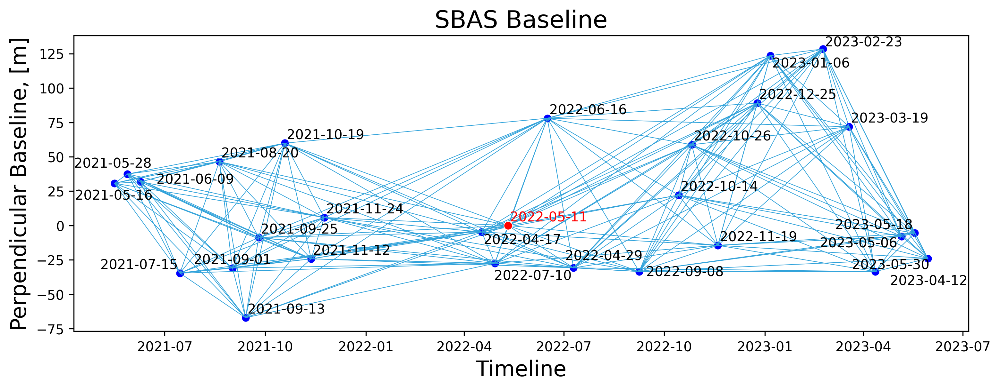

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

# plot dates/baselines marks
df = pd.DataFrame(np.concatenate([baseline_pairs[['ref', 'ref_baseline']],
                             baseline_pairs[['rep', 'rep_baseline']]]),
            columns=['date', 'baseline']).drop_duplicates()
sns.scatterplot(x='date', y='baseline', data=df, marker='o', color='b', s=40)
# plot reference date on top
sns.scatterplot(x='date', y='baseline', data=df[df.date==sbas.reference], marker='o', color='r', s=40, zorder=1000)

# plot pairs
for _, row in baseline_pairs.iterrows():
    plt.plot([row['ref'], row['rep']], [row['ref_baseline'], row['rep_baseline']], c='#30a2da', lw=0.5)

# Create annotations with adjust_text
texts = []
for x, y in df.values:
    texts.append(plt.text(x, y, str(x.date()), ha='center', va='bottom', fontsize=10,
                          c='r' if str(x.date()) == sbas.reference else 'black'))
adjustText.adjust_text(texts)

plt.xlabel('Timeline', fontsize=16)
plt.ylabel('Perpendicular Baseline, [m]', fontsize=16)
plt.title('SBAS Baseline', fontsize=18)

plt.show()

## SBAS Analysis

In [ ]:
# select subset of pairs or use all the pairs
#pairs, dates = sbas.get_pairs(baseline_pairs[:9], dates=True)
# or select all the pairs
pairs, dates = sbas.get_pairs(baseline_pairs, dates=True)

### Multi-looked Interferogram

In [ ]:
# load Sentinel-1 data
data = sbas.open_data(dates)
# Gaussian filtering N meter cut-off wavelength with multilooking on Sentinel-1 intensities
intensity = sbas.multilooking(np.square(np.abs(data)), wavelength=200, coarsen=(1,4))
# calculate phase difference with topography correction
phase = sbas.phasediff(pairs, data)
# Gaussian filtering N meter cut-off wavelength with multilooking
phase = sbas.multilooking(phase, wavelength=200, coarsen=(1,4))
corr = sbas.correlation(phase, intensity)
# convert complex phase difference to interferogram
intf = sbas.interferogram(phase)

In [ ]:
# optionally, materialize to disk and open
ds_sbas = sbas.sync_cube(xr.merge([intf, corr]), 'intf_sbas')
intf_sbas = ds_sbas.phase
corr_sbas = ds_sbas.correlation

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.core:Event loop was unresponsive in Nanny for 5.06s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 5.06s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Scheduler for 4.76s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 4.76s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.
INFO:distributed.core:Event loop was unresponsive in Nanny for 4.76s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeout

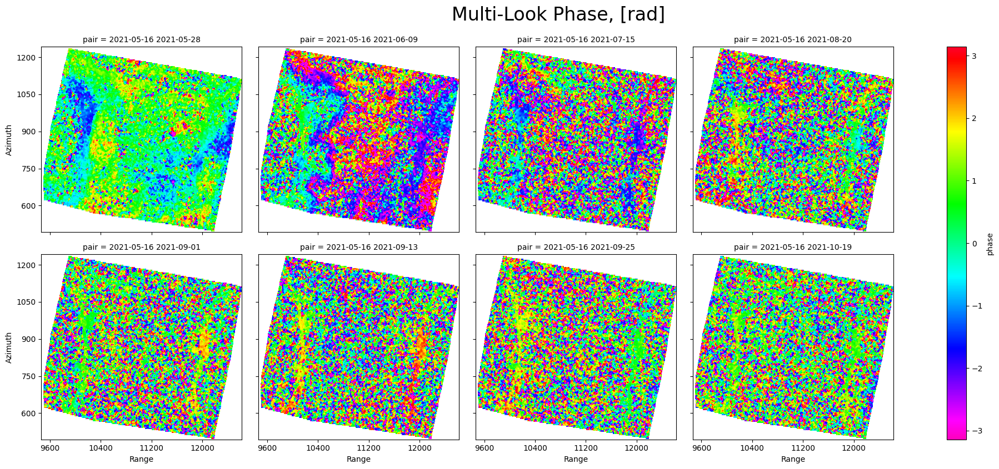

CPU times: user 2.87 s, sys: 580 ms, total: 3.45 s
Wall time: 3.17 s


In [ ]:
%%time
# multi-plots ineffective for linked lazy data
fg = intf_sbas[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Multi-Look Phase, [rad]', y=1.05, fontsize=24)
plt.show()

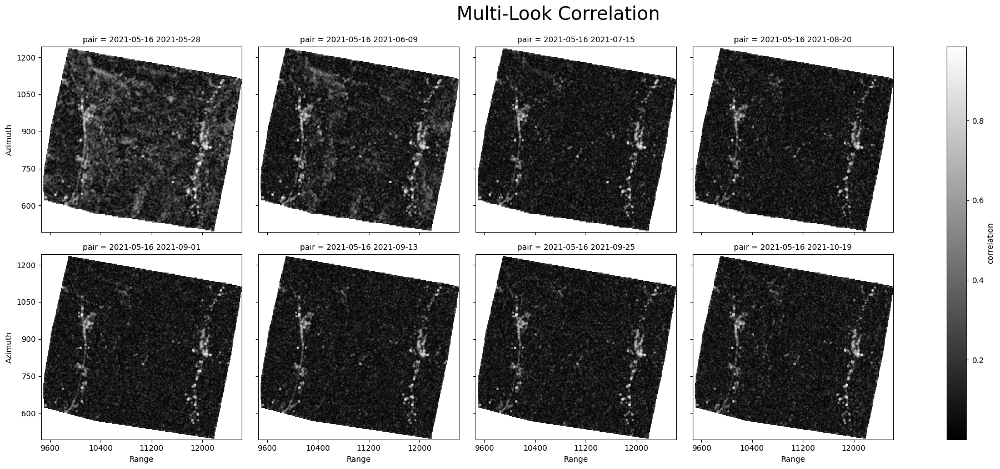

CPU times: user 2.69 s, sys: 539 ms, total: 3.22 s
Wall time: 2.96 s


In [ ]:
%%time
# multi-plots ineffective for linked lazy data
fg = corr_sbas[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    clim=(0, 0.8), cmap='gray'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Multi-Look Correlation', y=1.05, fontsize=24)
plt.show()

### 2D Unwrapping

In [ ]:
# CORRLIMIT = 0.075 ;# for gaussian 5000 and wavelength 400
CORRLIMIT = 0.125
corr_sbas_stack = corr_sbas.mean('pair')

In [ ]:
corr_sbas_stack = sbas.sync_cube(corr_sbas_stack, 'corr_sbas_stack')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

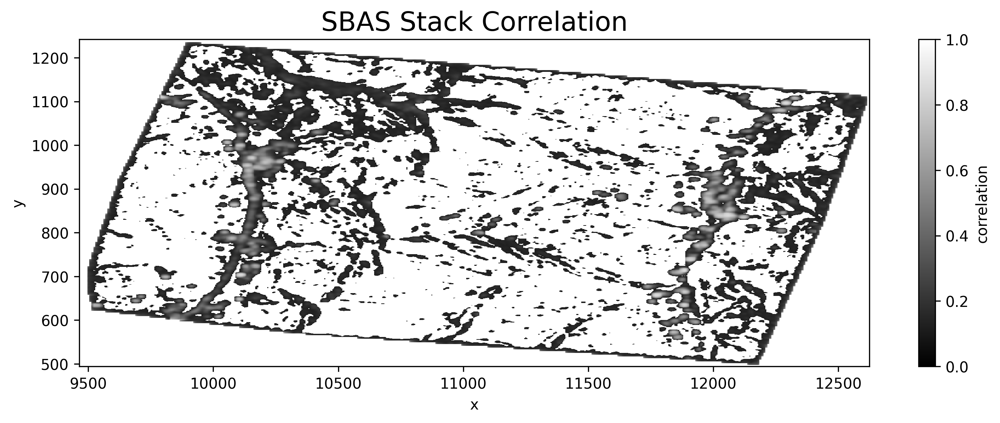

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)
corr_sbas_stack.where(corr_sbas_stack>=CORRLIMIT).plot.imshow(cmap='gray', vmin=0, vmax=1)
plt.title('SBAS Stack Correlation', fontsize=18)
plt.show()

In [ ]:
unwrap_sbas = sbas.unwrap_snaphu(intf_sbas.where(corr_sbas_stack>=CORRLIMIT), corr_sbas, conncomp=True)
unwrap_sbas

<xarray.Dataset>
Dimensions:   (pair: 201, y: 748, x: 790)
Coordinates:
    ref       (pair) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    rep       (pair) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
  * pair      (pair) object '2021-05-16 2021-05-28' ... '2023-05-18 2023-05-30'
  * y         (y) float64 494.5 495.5 496.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x         (x) float64 9.466e+03 9.47e+03 9.474e+03 ... 1.262e+04 1.262e+04
Data variables:
    phase     (pair, y, x) float32 dask.array<chunksize=(1, 748, 790), meta=np.ndarray>
    conncomp  (pair, y, x) float32 dask.array<chunksize=(1, 748, 790), meta=np.ndarray>

In [ ]:
# optionally, materialize to disk and open
unwrap_sbas = sbas.sync_cube(unwrap_sbas, 'unwrap_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

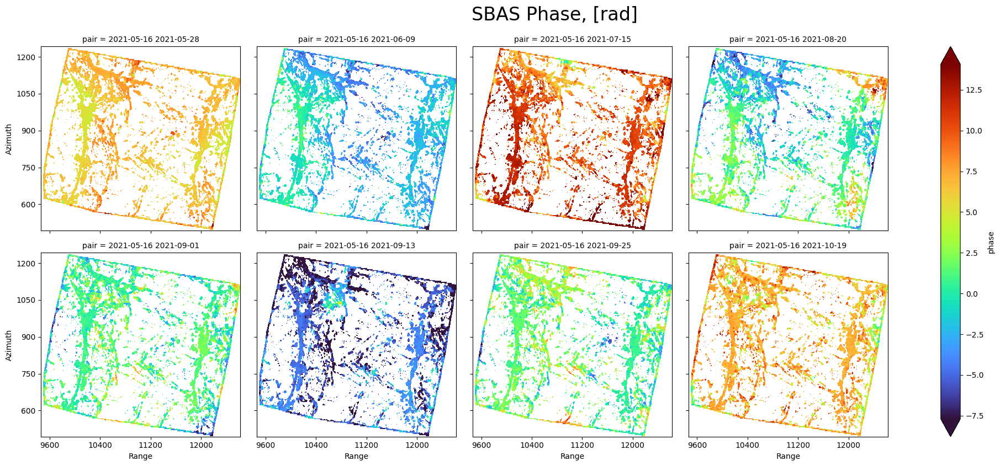

In [ ]:
zmin, zmax = np.nanquantile(unwrap_sbas.phase, [0.01, 0.99])
fg = unwrap_sbas.phase[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS Phase, [rad]', y=1.05, fontsize=24)
plt.show()

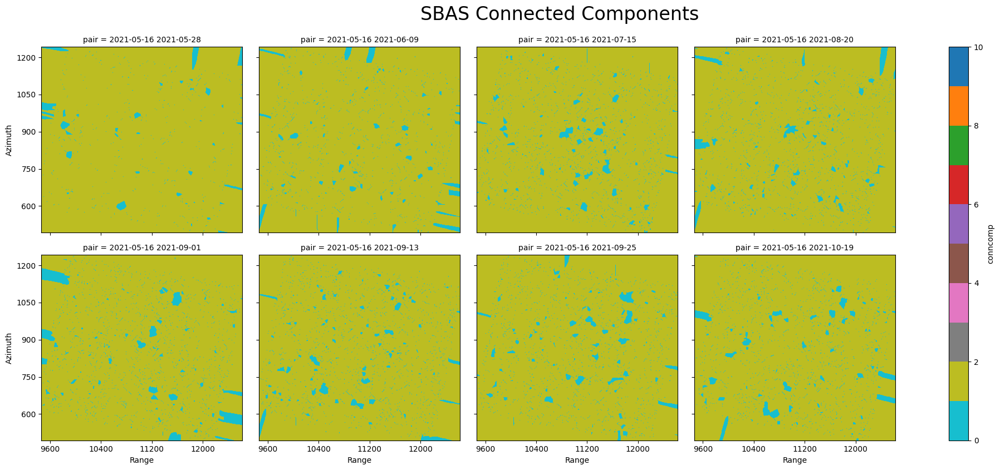

In [ ]:
fg = unwrap_sbas.conncomp[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    cmap='tab10_r', vmin=0, vmax=10
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS Connected Components', y=1.05, fontsize=24)
plt.show()

### Trend Estimation

In [ ]:
trend_sbas = sbas.gaussian(unwrap_sbas.phase, wavelength=10000)

In [ ]:
# optionally, materialize to disk and open
trend_sbas = sbas.sync_cube(trend_sbas, 'trend_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

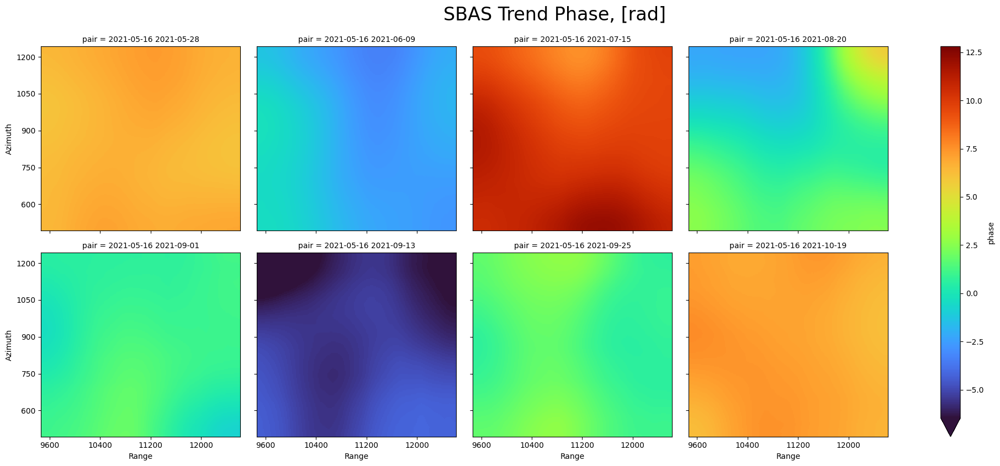

In [ ]:
zmin, zmax = np.nanquantile(trend_sbas, [0.01, 0.99])
fg = trend_sbas[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS Trend Phase, [rad]', y=1.05, fontsize=24)
plt.show()

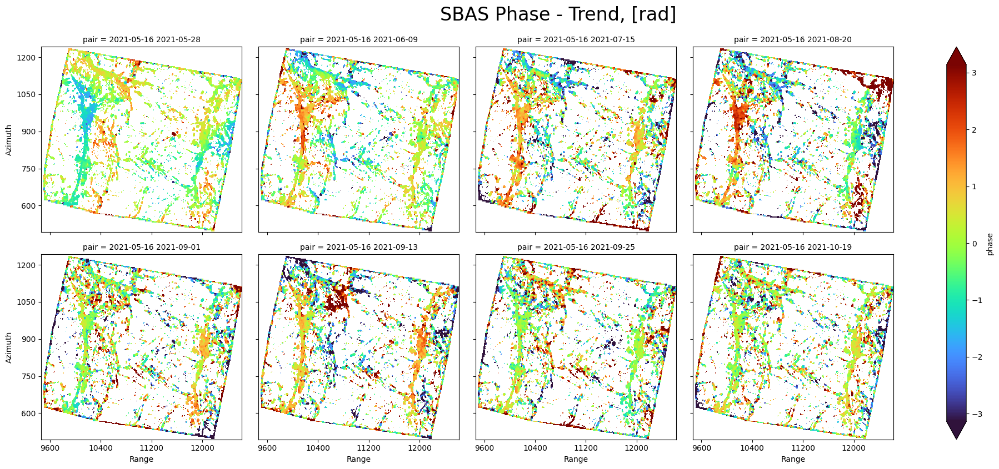

In [ ]:
fg = (unwrap_sbas.phase - trend_sbas)[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS Phase - Trend, [rad]', y=1.05, fontsize=24)
plt.show()

### Quality Check

In [ ]:
stddev_sbas = (unwrap_sbas.phase - trend_sbas).std(['y','x'])
stddev_sbas = sbas.sync_cube(stddev_sbas, 'stddev_sbas')
stddev_sbas

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

<xarray.DataArray 'phase' (pair: 201)>
dask.array<xarray-phase, shape=(201,), dtype=float32, chunksize=(1,), chunktype=numpy.ndarray>
Coordinates:
    ref      (pair) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
    rep      (pair) datetime64[ns] dask.array<chunksize=(1,), meta=np.ndarray>
  * pair     (pair) object '2021-05-16 2021-05-28' ... '2023-05-18 2023-05-30'

In [ ]:
pairs = sbas.get_pairs(baseline_pairs)
pairs['stddev'] = stddev_sbas.values
pairs

,ref,rep,ref_baseline,rep_baseline,baseline,pair,duration,stddev
0,2021-05-16,2021-05-28,30.67,37.43,6.76,2021-05-16 2021-05-28,12,1.016890
1,2021-05-16,2021-06-09,30.67,31.80,1.13,2021-05-16 2021-06-09,24,1.367994
2,2021-05-16,2021-07-15,30.67,-34.63,65.30,2021-05-16 2021-07-15,60,2.051183
3,2021-05-16,2021-08-20,30.67,46.44,15.77,2021-05-16 2021-08-20,96,2.356974
4,2021-05-16,2021-09-01,30.67,-30.93,61.60,2021-05-16 2021-09-01,108,1.964805
...,...,...,...,...,...,...,...,...
196,2023-04-12,2023-05-18,-33.49,-5.47,28.02,2023-04-12 2023-05-18,36,1.716114
197,2023-04-12,2023-05-30,-33.49,-23.89,9.60,2023-04-12 2023-05-30,48,1.391745
198,2023-05-06,2023-05-18,-7.87,-5.47,2.40,2023-05-06 2023-05-18,12,1.096913
199,2023-05-06,2023-05-30,-7.87,-23.89,16.02,2023-05-06 2023-05-30,24,1.441937


In [ ]:
pairs_best = sbas.sbas_pairs_covering(pairs, 'stddev', 2)
#pairs_best = pairs[pairs['stddev']<=1.55]
# optionally, drop dates having less then 2 pairs
pairs_best = sbas.sbas_pairs_limit(pairs_best, limit=2, iterations=2)
print (len(pairs_best))
pairs_best

39


,ref,rep,ref_baseline,rep_baseline,baseline,pair,duration,stddev
0,2021-05-16,2021-05-28,30.67,37.43,6.76,2021-05-16 2021-05-28,12,1.016890
1,2021-05-16,2021-06-09,30.67,31.80,1.13,2021-05-16 2021-06-09,24,1.367994
2,2021-05-28,2021-06-09,37.43,31.80,5.63,2021-05-28 2021-06-09,12,1.636640
3,2021-05-28,2021-09-25,37.43,-8.74,46.17,2021-05-28 2021-09-25,120,1.759253
4,2021-05-28,2021-10-19,37.43,59.90,22.47,2021-05-28 2021-10-19,144,1.759728
5,2021-07-15,2021-09-01,-34.63,-30.93,3.70,2021-07-15 2021-09-01,48,1.606115
6,2021-07-15,2021-09-13,-34.63,-67.07,32.44,2021-07-15 2021-09-13,60,1.710405
7,2021-08-20,2021-09-13,46.44,-67.07,113.51,2021-08-20 2021-09-13,24,1.512159
8,2021-08-20,2021-10-19,46.44,59.90,13.46,2021-08-20 2021-10-19,60,1.515026
9,2021-09-01,2021-09-13,-30.93,-67.07,36.14,2021-09-01 2021-09-13,12,1.460846


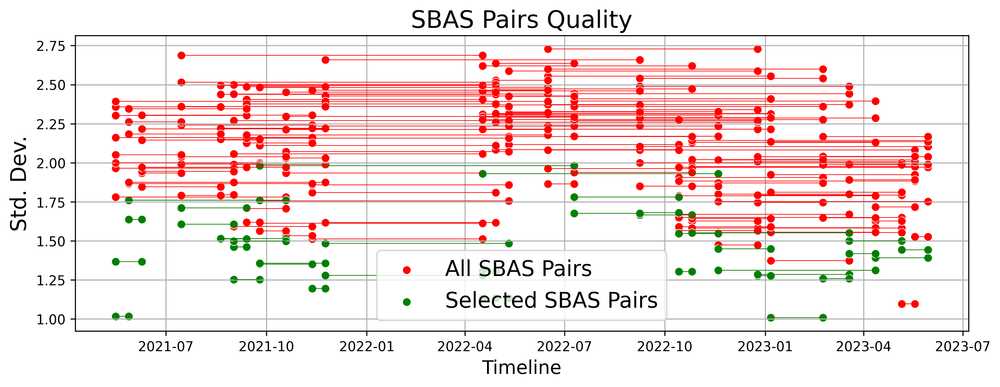

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

# plot dates/baselines marks
df = pd.DataFrame(np.concatenate([pairs[['ref', 'stddev']], pairs[['rep', 'stddev']]]),
                                 columns=['date', 'stddev']).drop_duplicates()
sns.scatterplot(x='date', y='stddev', data=df, marker='o', color='r', s=40, label='All SBAS Pairs')

df_best = pd.DataFrame(np.concatenate([pairs_best[['ref', 'stddev']], pairs_best[['rep', 'stddev']]]),
                                 columns=['date', 'stddev']).drop_duplicates()
sns.scatterplot(x='date', y='stddev', data=df_best, marker='o', color='g', s=40, label='Selected SBAS Pairs')

# plot pairs
for _, row in pairs.iterrows():
    plt.plot([row['ref'], row['rep']], [row['stddev'], row['stddev']], c='r', lw=0.5)

for _, row in pairs_best.iterrows():
    plt.plot([row['ref'], row['rep']], [row['stddev'], row['stddev']], c='g', lw=0.5)

plt.legend(fontsize=16)
plt.xlabel('Timeline', fontsize=14)
plt.ylabel('Std. Dev.', fontsize=16)
plt.title('SBAS Pairs Quality', fontsize=18)
plt.grid()
plt.show()

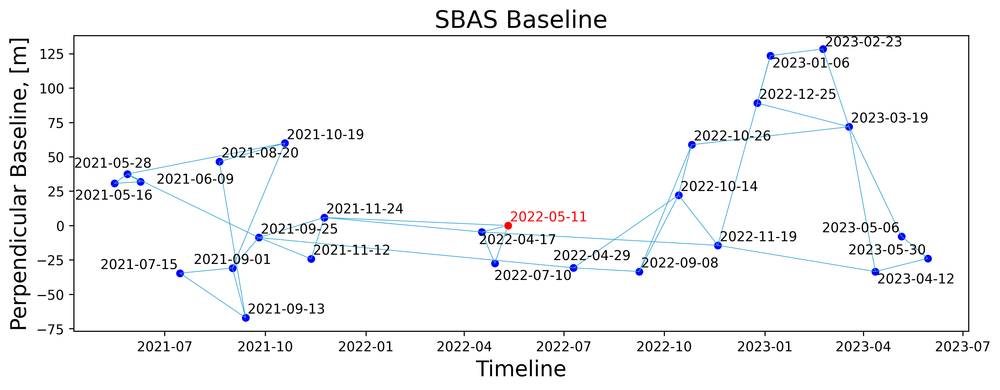

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

# plot dates/baselines marks
df = pd.DataFrame(np.concatenate([pairs_best[['ref', 'ref_baseline']],
                             pairs_best[['rep', 'rep_baseline']]]),
            columns=['date', 'baseline']).drop_duplicates()
sns.scatterplot(x='date', y='baseline', data=df, marker='o', color='b', s=40)
# plot reference date on top
sns.scatterplot(x='date', y='baseline', data=df[df.date==sbas.reference], marker='o', color='r', s=40, zorder=1000)

# plot pairs
for _, row in pairs_best.iterrows():
    plt.plot([row['ref'], row['rep']], [row['ref_baseline'], row['rep_baseline']], c='#30a2da', lw=0.5)

# Create annotations with adjust_text
texts = []
for x, y in df.values:
    texts.append(plt.text(x, y, str(x.date()), ha='center', va='bottom', fontsize=10,
                          c='r' if str(x.date()) == sbas.reference else 'black'))
adjustText.adjust_text(texts)

plt.xlabel('Timeline', fontsize=16)
plt.ylabel('Perpendicular Baseline, [m]', fontsize=16)
plt.title('SBAS Baseline', fontsize=18)

plt.show()

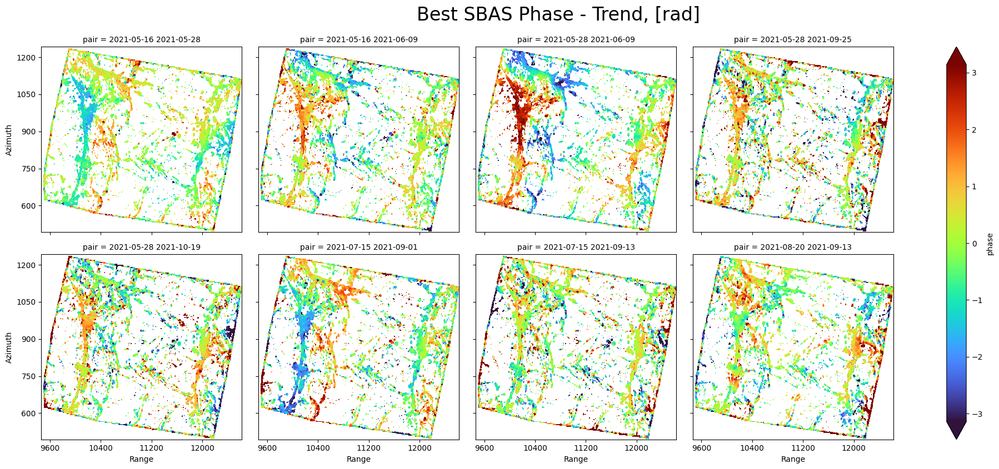

In [ ]:
fg = (unwrap_sbas.phase - trend_sbas).sel(pair=pairs_best.pair.values)[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Best SBAS Phase - Trend, [rad]', y=1.05, fontsize=24)
plt.show()

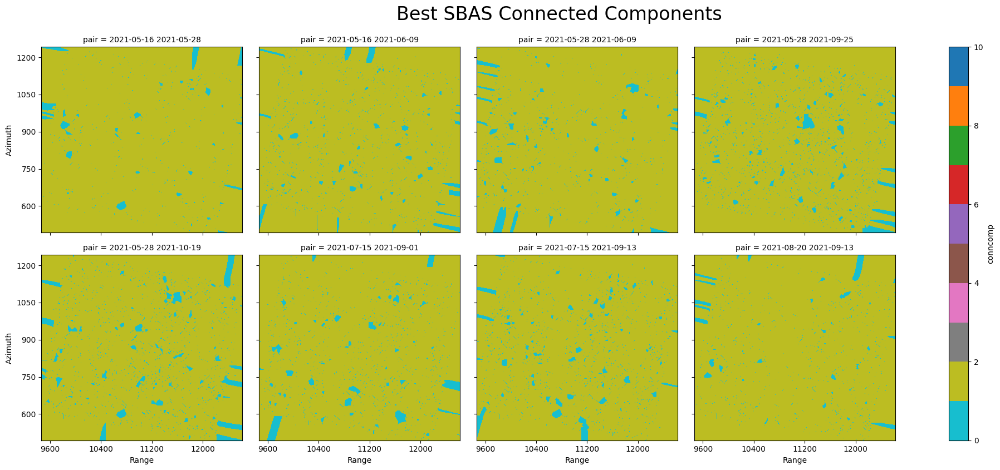

In [ ]:
fg = unwrap_sbas.conncomp.sel(pair=pairs_best.pair.values)[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    cmap='tab10_r', vmin=0, vmax=10
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Best SBAS Connected Components', y=1.05, fontsize=24)
plt.show()

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [ ]:
# calculate phase displacement in radians and convert to LOS displacement in millimeter
disp_sbas = sbas.los_displacement_mm(sbas.lstsq((unwrap_sbas.phase - trend_sbas).sel(pair=pairs_best.pair.values),
                                                    corr_sbas.sel(pair=pairs_best.pair.values)))

Note: data chunk size (748, 790) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk


In [ ]:
# optionally, materialize to disk and open
disp_sbas = sbas.sync_cube(disp_sbas, 'disp_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

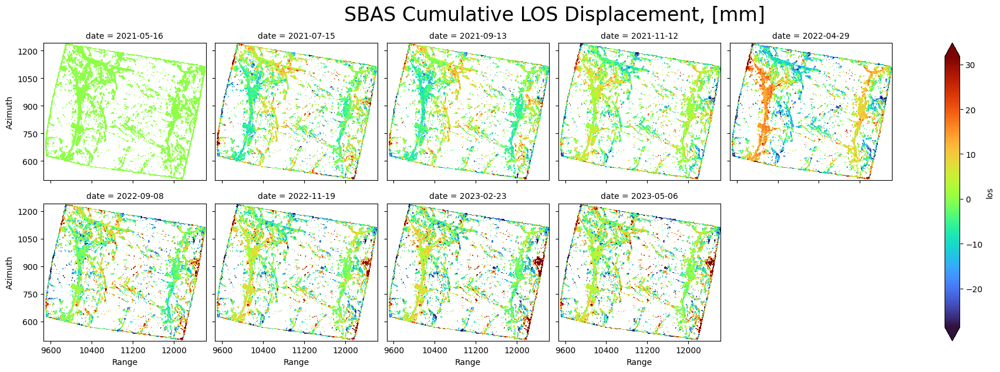

In [ ]:
zmin, zmax = np.nanquantile(disp_sbas, [0.01, 0.99])
fg = disp_sbas[::3].plot.imshow(
    col="date",
    col_wrap=5, size=3, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('SBAS Cumulative LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

### STL model for LOS Displacement, mm

In [ ]:
stl_sbas = sbas.stl(disp_sbas)
stl_sbas

Note: data chunk size (748, 790) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk


<xarray.Dataset>
Dimensions:   (date: 107, y: 748, x: 790)
Coordinates:
  * date      (date) datetime64[ns] 2021-05-16 2021-05-23 ... 2023-05-28
  * y         (y) float64 494.5 495.5 496.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x         (x) float64 9.466e+03 9.47e+03 9.474e+03 ... 1.262e+04 1.262e+04
Data variables:
    trend     (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>
    seasonal  (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>
    resid     (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>

In [ ]:
stl_sbas = sbas.sync_cube(stl_sbas, 'stl_sbas')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
%%time
years = ((stl_sbas.date.max() - stl_sbas.date.min()).dt.days/365.25).item()
print ('years', np.round(years, 3))
# for linear trend
velocity_sbas = (stl_sbas.trend[-1] - stl_sbas.trend[0])/years
velocity_sbas

years 2.031
CPU times: user 13.7 ms, sys: 980 µs, total: 14.7 ms
Wall time: 15 ms


<xarray.DataArray 'trend' (y: 748, x: 790)>
dask.array<truediv, shape=(748, 790), dtype=float32, chunksize=(748, 790), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 494.5 495.5 496.5 497.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x        (x) float64 9.466e+03 9.47e+03 9.474e+03 ... 1.262e+04 1.262e+04

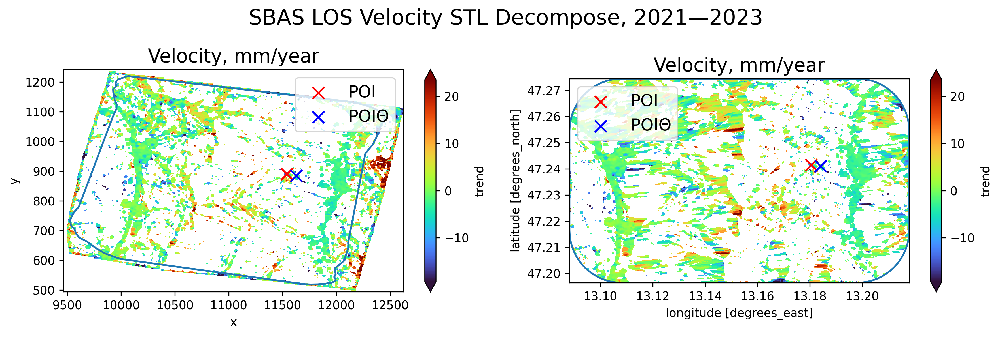

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_sbas, [0.01, 0.99])

ax = fig.add_subplot(1, 2, 1)
velocity_sbas.plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
sbas.geocode(AOI.boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.legend(fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry)\
    .plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
AOI.boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('SBAS LOS Velocity STL Decompose, 2021—2023', fontsize=18)
plt.tight_layout()
plt.show()

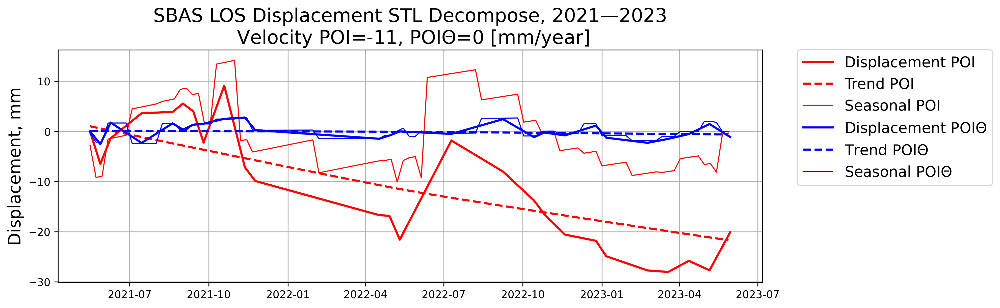

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_sbas.sel(y=y, x=x, method='nearest')
stl_pixel = stl_sbas.sel(y=y, x=x, method='nearest')
velocity_pixel = int(velocity_sbas.sel(y=y, x=x, method='nearest').round())
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp_sbas.sel(y=y, x=x, method='nearest')
stl_pixel = stl_sbas.sel(y=y, x=x, method='nearest')
velocity_pixel0 = int(velocity_sbas.sel(y=y, x=x, method='nearest').round())
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title(f'SBAS LOS Displacement STL Decompose, 2021—2023\n Velocity POI={velocity_pixel}, POI$\Theta$={velocity_pixel0} [mm/year]', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.grid()
plt.show()

## PS Analysis

Use the best interferograms and trend detected on lower resolution SBAS phas for higher resolution PSI analysis.

In [ ]:
# select subset of pairs or use all the pairs
#pairs, dates = sbas.get_pairs(baseline_pairs[:9], dates=True)
pairs, dates = sbas.get_pairs(pairs_best, dates=True)
# or select all the pairs
#pairs, dates = sbas.get_pairs(baseline_pairs, dates=True)

In [ ]:
# load Sentinel-1 data
data = sbas.open_data(dates)
# Gaussian filtering N meter cut-off wavelength with multilooking on Sentinel-1 intensities
intensity = sbas.multilooking(np.square(np.abs(data)), wavelength=30)
# calculate phase difference with topography correction
phase = sbas.phasediff(pairs, data)
# Gaussian filtering N meter cut-off wavelength with multilooking
phase = sbas.multilooking(phase, wavelength=30)
corr = sbas.correlation(phase, intensity)
# convert complex phase difference to interferogram
intf = sbas.interferogram(phase)

In [ ]:
# optionally, materialize to disk and open
ds_ps = sbas.sync_cube(xr.merge([intf, corr]), 'intf_ps')
intf_ps = ds_ps.phase
corr_ps = ds_ps.correlation

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

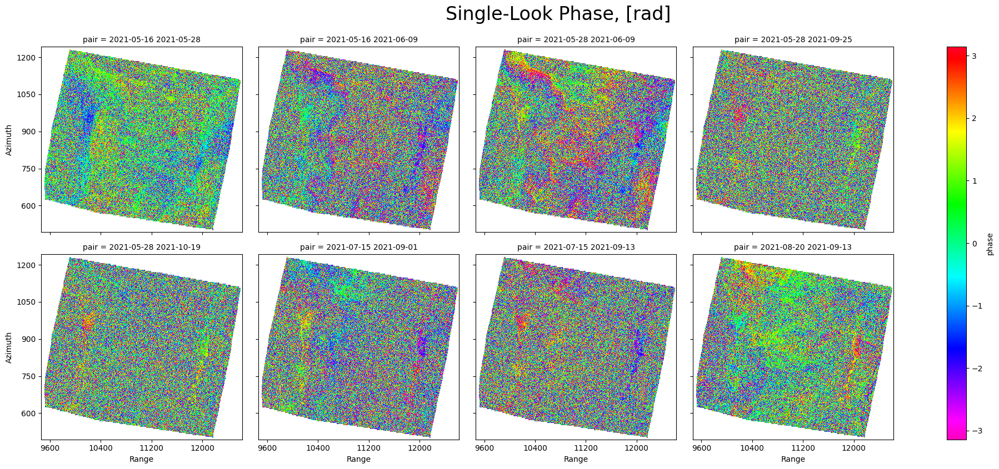

CPU times: user 3.58 s, sys: 1.27 s, total: 4.84 s
Wall time: 4.16 s


In [ ]:
%%time
# multi-plots ineffective for linked lazy data
fg = intf_ps[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Single-Look Phase, [rad]', y=1.05, fontsize=24)
plt.show()

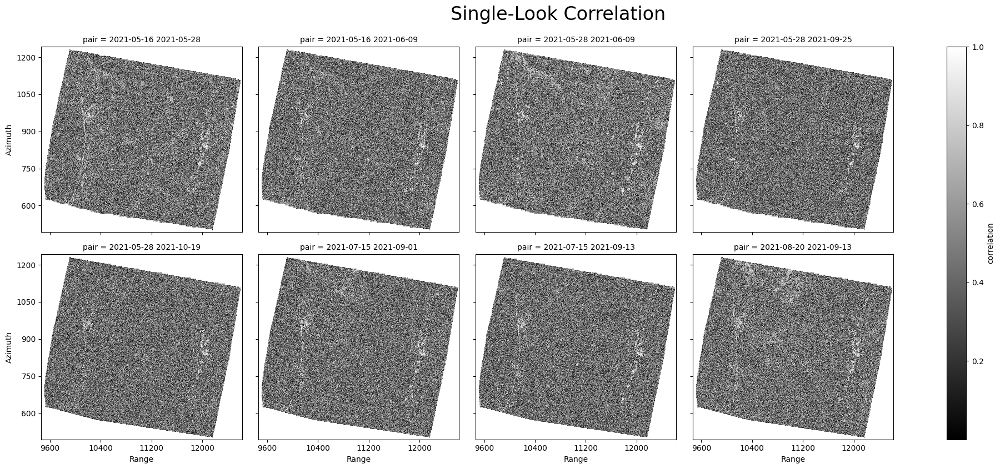

CPU times: user 3.32 s, sys: 775 ms, total: 4.09 s
Wall time: 3.91 s


In [ ]:
%%time
# multi-plots ineffective for linked lazy data
fg = corr_ps[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    clim=(0, 0.8), cmap='gray'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Single-Look Correlation', y=1.05, fontsize=24)
plt.show()

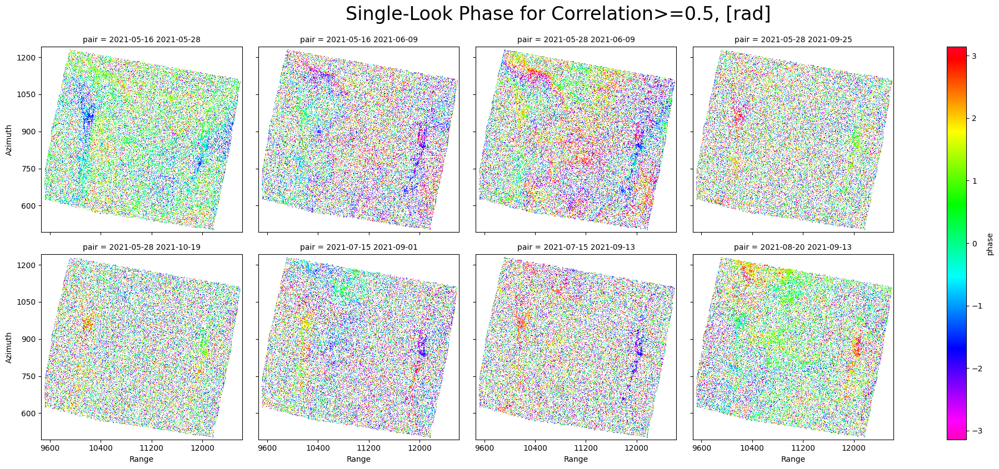

CPU times: user 3.57 s, sys: 790 ms, total: 4.36 s
Wall time: 4.31 s


In [ ]:
%%time
# multi-plots ineffective for linked lazy data
fg = intf_ps.where(corr_ps>=0.5)[:8].plot.imshow(
    col="pair",
    col_wrap=4, size=4, aspect=1.2,
    vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('Single-Look Phase for Correlation>=0.5, [rad]', y=1.05, fontsize=24)
plt.show()

### 1D Unwrapping for LOS Displacement, mm

In [ ]:
# interpolate trend and turbulence component for high resolution interferograms
trend_ps = trend_sbas.interp_like(intf_ps.sel(pair=pairs_best.pair.values), method='linear')

In [ ]:
PSCORRLIMIT = 0.6
corr_ps_stack = corr_ps.sel(pair=pairs_best.pair.values).mean('pair')

In [ ]:
corr_ps_stack = sbas.sync_cube(corr_ps_stack, 'corr_ps_stack')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

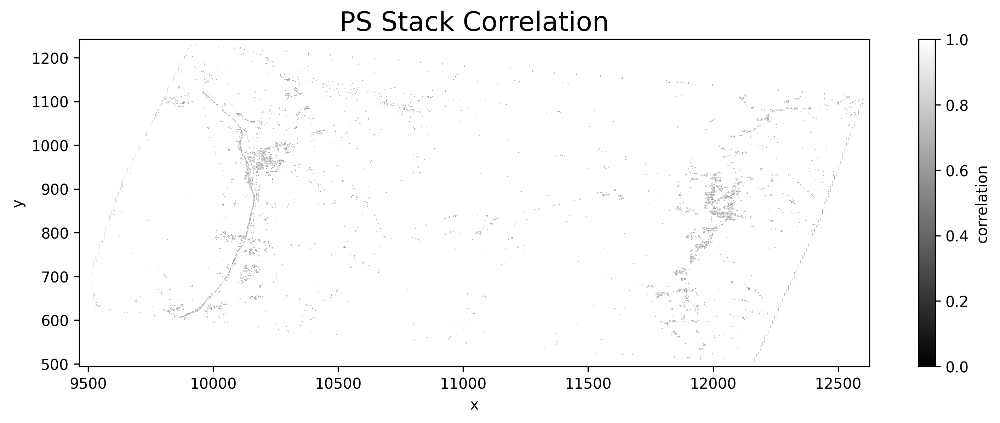

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)
corr_ps_stack.where(corr_ps_stack>=PSCORRLIMIT).plot.imshow(cmap='gray', vmin=0, vmax=1)
plt.title('PS Stack Correlation', fontsize=18)
plt.show()

In [ ]:
disp_ps_pairs = sbas.los_displacement_mm(sbas.unwrap1d(
    sbas.wrap(intf_ps - trend_ps).where(corr_ps_stack>PSCORRLIMIT).sel(pair=pairs_best.pair.values)
    ))
disp_ps_pairs

Note: data chunk size (748, 2048) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk


<xarray.DataArray 'los' (pair: 39, y: 748, x: 3161)>
dask.array<multiply, shape=(39, 748, 3161), dtype=float32, chunksize=(39, 256, 256), chunktype=numpy.ndarray>
Coordinates:
    ref      (pair) datetime64[ns] dask.array<chunksize=(39,), meta=np.ndarray>
    rep      (pair) datetime64[ns] dask.array<chunksize=(39,), meta=np.ndarray>
  * pair     (pair) object '2021-05-16 2021-05-28' ... '2023-05-06 2023-05-30'
  * y        (y) float64 494.5 495.5 496.5 497.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x        (x) float64 9.464e+03 9.466e+03 9.466e+03 ... 1.262e+04 1.262e+04

In [ ]:
disp_ps_pairs = sbas.sync_cube(disp_ps_pairs, 'disp_ps_pairs')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Coherence-Weighted Least-Squares Solution for LOS Displacement, mm

In [ ]:
disp_ps = sbas.lstsq(disp_ps_pairs, corr_ps.sel(pair=pairs_best.pair.values))
disp_ps

Note: data chunk size (748, 2048) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk


<xarray.DataArray 'displacement' (date: 26, y: 748, x: 3161)>
dask.array<concatenate, shape=(26, 748, 3161), dtype=float32, chunksize=(26, 256, 256), chunktype=numpy.ndarray>
Coordinates:
  * date     (date) datetime64[ns] 2021-05-16 2021-05-28 ... 2023-05-30
  * y        (y) float64 494.5 495.5 496.5 497.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x        (x) float64 9.464e+03 9.466e+03 9.466e+03 ... 1.262e+04 1.262e+04

In [ ]:
disp_ps = sbas.sync_cube(disp_ps, 'disp_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

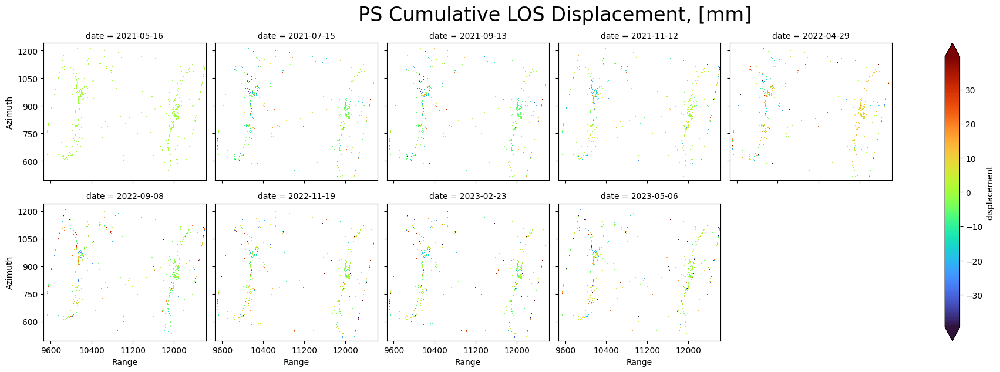

In [ ]:
zmin, zmax = np.nanquantile(disp_ps, [0.01, 0.99])
fg = disp_ps[::3].plot.imshow(
    col="date",
    col_wrap=5, size=3, aspect=1.2,
    vmin=zmin, vmax=zmax, cmap='turbo'
)
fg.set_axis_labels('Range', 'Azimuth')
fg.set_ticks(max_xticks=5, max_yticks=5, fontsize='medium')
fg.fig.suptitle('PS Cumulative LOS Displacement, [mm]', y=1.05, fontsize=24)
plt.show()

### STL model for LOS Displacement, mm

In [ ]:
stl_ps = sbas.stl(disp_ps)
stl_ps

Note: data chunk size (748, 2048) is too large for stack processing
Note: auto tune data chunk size to a half of NetCDF chunk


<xarray.Dataset>
Dimensions:   (date: 107, y: 748, x: 3161)
Coordinates:
  * date      (date) datetime64[ns] 2021-05-16 2021-05-23 ... 2023-05-28
  * y         (y) float64 494.5 495.5 496.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x         (x) float64 9.464e+03 9.466e+03 9.466e+03 ... 1.262e+04 1.262e+04
Data variables:
    trend     (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>
    seasonal  (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>
    resid     (date, y, x) float32 dask.array<chunksize=(107, 256, 256), meta=np.ndarray>

In [ ]:
stl_ps = sbas.sync_cube(stl_ps, 'stl_ps')

Syncing NetCDF 2D/3D Dataset:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

In [ ]:
%%time
years = ((stl_ps.date.max() - stl_ps.date.min()).dt.days/365.25).item()
print ('years', np.round(years, 3))
# for linear trend
velocity_ps = (stl_ps.trend[-1] - stl_ps.trend[0])/years
velocity_ps

years 2.031
CPU times: user 13.8 ms, sys: 1.09 ms, total: 14.9 ms
Wall time: 14.9 ms


<xarray.DataArray 'trend' (y: 748, x: 3161)>
dask.array<truediv, shape=(748, 3161), dtype=float32, chunksize=(748, 2048), chunktype=numpy.ndarray>
Coordinates:
  * y        (y) float64 494.5 495.5 496.5 497.5 ... 1.24e+03 1.24e+03 1.242e+03
  * x        (x) float64 9.464e+03 9.466e+03 9.466e+03 ... 1.262e+04 1.262e+04

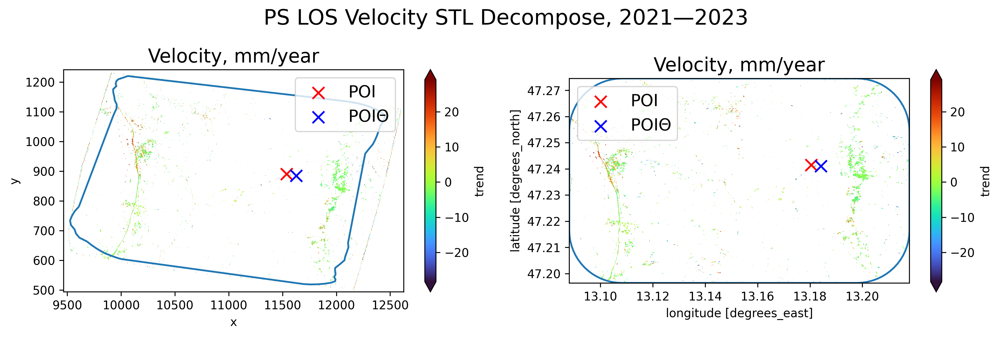

In [ ]:
fig = plt.figure(figsize=(12,4), dpi=300)

zmin, zmax = np.nanquantile(velocity_ps, [0.01, 0.99])

ax = fig.add_subplot(1, 2, 1)
velocity_ps.plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
sbas.geocode(AOI.boundary).plot(ax=ax)
sbas.geocode(POI).plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
sbas.geocode(POI0).plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.set_aspect('auto')
ax.legend(fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

ax = fig.add_subplot(1, 2, 2)
sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry)\
    .plot.imshow(cmap='turbo', vmin=zmin, vmax=zmax, ax=ax)
AOI.boundary.plot(ax=ax)
POI.plot(ax=ax, marker='x', c='r', markersize=100, label='POI')
POI0.plot(ax=ax, marker='x', c='b', markersize=100, label='POI$\Theta$')
ax.legend(loc='upper left', fontsize=14)
ax.set_title('Velocity, mm/year', fontsize=16)

plt.suptitle('PS LOS Velocity STL Decompose, 2021—2023', fontsize=18)
plt.tight_layout()
plt.show()

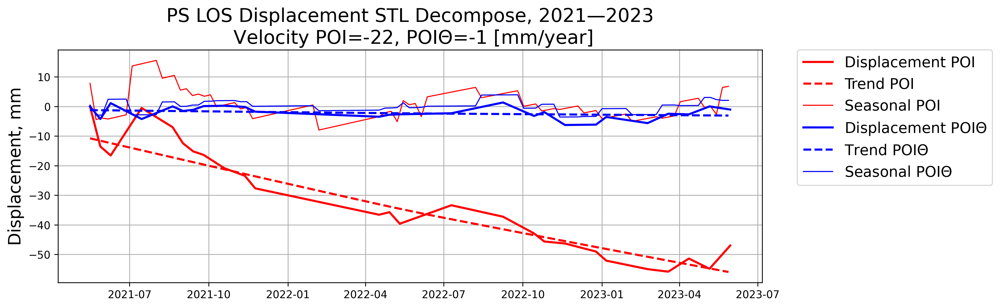

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = stl_ps.sel(y=y, x=x, method='nearest')
velocity_pixel = int(velocity_ps.sel(y=y, x=x, method='nearest').round())
plt.plot(disp_pixel.date, disp_pixel, c='r', lw=2, label='Displacement POI')
plt.plot(stl_pixel.date, stl_pixel.trend, c='r', ls='--', lw=2, label='Trend POI')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='r', lw=1, label='Seasonal POI')

x, y = [(geom.x.item(), geom.y.item()) for geom in sbas.geocode(POI0).geometry][0]
disp_pixel = disp_ps.sel(y=y, x=x, method='nearest')
stl_pixel = stl_ps.sel(y=y, x=x, method='nearest')
velocity_pixel0 = int(velocity_ps.sel(y=y, x=x, method='nearest').round())
plt.plot(disp_pixel.date, disp_pixel, c='b', lw=2, label='Displacement POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.trend, c='b', ls='--', lw=2, label='Trend POI$\Theta$')
plt.plot(stl_pixel.date, stl_pixel.seasonal, c='b', lw=1, label='Seasonal POI$\Theta$')

plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, fontsize=14)
plt.title(f'PS LOS Displacement STL Decompose, 2021—2023\n Velocity POI={velocity_pixel}, POI$\Theta$={velocity_pixel0} [mm/year]', fontsize=18)
plt.ylabel('Displacement, mm', fontsize=16)
plt.grid()
plt.show()

## SBAS vs PS Comparision

In [ ]:
# crop AOI
points_sbas = sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.clip(AOI.geometry)
points_ps = sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.clip(AOI.geometry)
points_ps = points_ps.interp_like(points_sbas, method='nearest').values.ravel()
points_sbas = points_sbas.values.ravel()
nanmask = np.isnan(points_sbas) | np.isnan(points_ps)
points_sbas = points_sbas[~nanmask]
points_ps = points_ps[~nanmask]

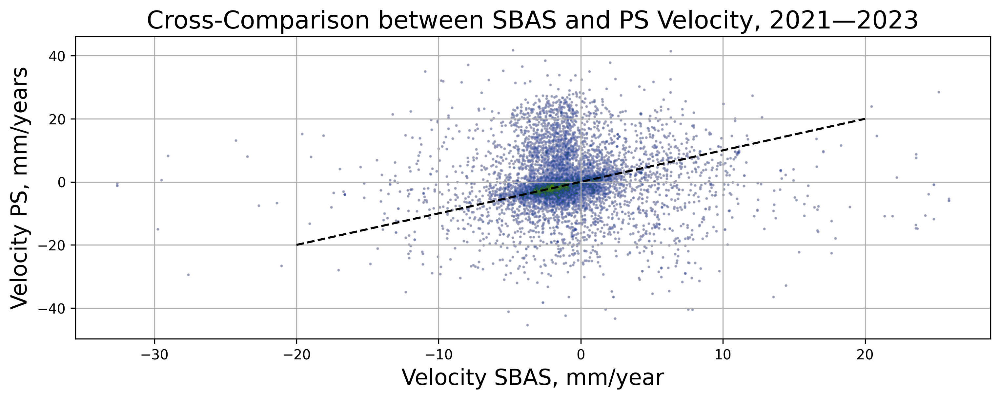

In [ ]:
plt.figure(figsize=(12, 4), dpi=300)
plt.scatter(points_sbas, points_ps, c='silver', alpha=1,   s=1)
plt.scatter(points_sbas, points_ps, c='b',      alpha=0.1, s=1)
plt.scatter(points_sbas, points_ps, c='g',      alpha=0.1, s=0.1)
plt.scatter(points_sbas, points_ps, c='y',      alpha=0.1, s=0.01)

# adding a 1:1 line
#max_value = min(velocity_sbas.max(), velocity_ps.max())
#min_value = max(velocity_sbas.min(), velocity_ps.min())
max_value = 20
min_value = -20
plt.plot([min_value, max_value], [min_value, max_value], 'k--')

plt.xlabel('Velocity SBAS, mm/year', fontsize=16)
plt.ylabel('Velocity PS, mm/years', fontsize=16)
plt.title('Cross-Comparison between SBAS and PS Velocity, 2021—2023', fontsize=18)
plt.grid(True)
plt.show()

## 3D Interactive Map

In [ ]:
velocity_sbas_ll = sbas.ra2ll(velocity_sbas)
velocity_ps_ll = sbas.ra2ll(velocity_ps)

#velocity_sbas_ll = sbas.as_geo(velocity_sbas_ll).rio.clip(AOI.geometry.buffer(-BUFFER/2).envelope)
#velocity_ps_ll = sbas.as_geo(velocity_ps_ll).rio.clip(AOI.geometry.buffer(-BUFFER/2).envelope)

In [ ]:
gmap_tiles = XYZTiles().download(velocity_sbas_ll, 14)

XYZ Tile Downloading:   0%|          | 0/42 [00:00<?, ?it/s]

In [ ]:
for name, velocity_ll in {'sbas': velocity_sbas_ll, 'ps': velocity_ps_ll}.items():
    # decimate large grid
    if name == 'ps':
        velocity_ll = velocity_ll.sel(lat=velocity_ll.lat, lon=velocity_ll.lon[::4])
    velocity_ll = velocity_ll.sel(lat=velocity_ll.lat[::2], lon=velocity_ll.lon)
    ds = xr.merge([dem.interp_like(velocity_ll, method='cubic').rename('z'),
                   gmap_tiles.interp_like(velocity_ll, method='cubic').round().astype(np.uint8),
                   velocity_ll])
    # convert to VTK structure
    vtk_grid = pv.StructuredGrid(NCubeVTK.ImageOnTopography(ds.rename({'lat': 'y', 'lon': 'x'})))
    vtk_grid.save(f'velocity_{name}.vtk')
    print (vtk_grid)

StructuredGrid (0x78d147b02980)
  N Cells:      208992
  N Points:     209976
  X Bounds:     1.309e+01, 1.322e+01
  Y Bounds:     4.720e+01, 4.727e+01
  Z Bounds:     8.550e+02, 2.339e+03
  Dimensions:   673, 312, 1
  N Arrays:     2
StructuredGrid (0x78d1e38eda20)
  N Cells:      209303
  N Points:     210288
  X Bounds:     1.309e+01, 1.322e+01
  Y Bounds:     4.720e+01, 4.727e+01
  Z Bounds:     8.549e+02, 2.337e+03
  Dimensions:   674, 312, 1
  N Arrays:     2


In [ ]:
plotter = pv.Plotter(shape=(2, 1), notebook=True)
axes = pv.Axes(show_actor=True, actor_scale=2.0, line_width=5)

plotter.subplot(0, 0)
vtk_grid = pv.read('velocity_sbas.vtk')
mesh = vtk_grid\
    .scale([1, 1, 0.00001], inplace=True)\
    .rotate_z(135, point=axes.origin, inplace=True)
plotter.add_mesh(mesh, scalars='colors', rgb=True, ambient=0.2)
plotter.add_mesh(mesh, scalars='trend', ambient=0.2, cmap='turbo', clim=(-20,20), opacity=0.5)
plotter.show_axes()
plotter.add_title('SBAS LOS Velocity', font_size=32)

plotter.subplot(1, 0)
vtk_grid = pv.read('velocity_ps.vtk')
mesh = vtk_grid\
    .scale([1, 1, 0.00001], inplace=True)\
    .rotate_z(135, point=axes.origin, inplace=True)
plotter.add_mesh(mesh, scalars='colors', rgb=True, ambient=0.2)
plotter.add_mesh(mesh, scalars='trend', ambient=0.2, cmap='turbo', clim=(-20,20), opacity=0.5)
plotter.show_axes()
plotter.add_title('PS LOS Velocity', font_size=32)

plotter.show_axes()
plotter._on_first_render_request()
panel.panel(
    plotter.render_window, orientation_widget=plotter.renderer.axes_enabled,
    enable_keybindings=False, sizing_mode='stretch_width', min_height=600
)

VTKRenderWindowSynchronized(vtkXOpenGLRenderWindow, color_mappers=[LinearColorMapper(id='17a...], min_height=600, orientation_widget=True, sizing_mode='stretch_width')

## Export GeoJSON, GeoTIFF, VTK files from Google Colab

In [ ]:
# # NetCDF export in geographic coordinates
# # note: recent QGIS cannot open the files properly while GDAL process them well
# filename = 'velocity_sbas.nc'
# os.remove(filename) if os.path.exists(filename) else None
# with dask.config.set(scheduler='synchronous'):
#     sbas.as_geo(velocity_sbas_ll).to_netcdf(filename, engine='netcdf4')

# filename = 'velocity_ps.nc'
# os.remove(filename) if os.path.exists(filename) else None
# with dask.config.set(scheduler='synchronous'):
#     sbas.as_geo(velocity_ps_ll).to_netcdf(filename, engine='netcdf4')

In [ ]:
# GeoTIFF export
sbas.as_geo(sbas.ra2ll(velocity_sbas)).rio.to_raster('velocity_sbas.tif')
sbas.as_geo(sbas.ra2ll(velocity_ps)).rio.to_raster('velocity_ps.tif')

In [ ]:
# GeoJSON export
df_sbas = sbas.ra2ll(velocity_sbas.round()).stack(points=['lat', 'lon']).dropna(dim='points').to_dataframe()
df_sbas = gpd.GeoDataFrame(df_sbas['trend'].values,
                 geometry=gpd.points_from_xy(df_sbas['lon'].values, df_sbas['lat'].values),
                 columns=['velocity'])
df_sbas.to_file('velocity_sbas.json', driver='GeoJSON')

df_ps = sbas.ra2ll(velocity_ps.round()).stack(points=['lat', 'lon']).dropna(dim='points').to_dataframe()
df_ps = gpd.GeoDataFrame(df_ps['trend'].values,
                 geometry=gpd.points_from_xy(df_ps['lon'].values, df_ps['lat'].values),
                 columns=['velocity'])
df_ps.to_file('velocity_ps.json', driver='GeoJSON')

In [ ]:
# allow to download; alternatively, these files available in file manager panel
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download('velocity_sbas.tif')
    files.download('velocity_ps.tif')
    files.download('velocity_sbas.json')
    files.download('velocity_ps.json')
    files.download('velocity_sbas.vtk')
    files.download('velocity_ps.vtk')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Conclusion

For now you have the full control on interferometry processing and unwrapping and able to run it everywhere: on free of charge Google Colab instances, on local MacOS and Linux computers and on Amazon EC2 and Google Cloud VM and AI Notebook instances.